**Importing data from Kaggle**

In [1]:
! pip install -q kaggle
from google.colab import files
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle (2).json
mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle datasets download -d sbaghbidi/human-faces-object-detection

In [ ]:
!unzip human-faces-object-detection.zip

In [4]:
import os
import cv2 as cv
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from keras.models import Sequential
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from keras.layers import Conv2D, MaxPool2D, GlobalAveragePooling2D, Dropout, BatchNormalization, Dense

**Reading the Inputs**

In [5]:
df = pd.read_csv('/content/faces.csv')

In [6]:
df.head()

,image_name,width,height,x0,y0,x1,y1
0,00001722.jpg,1333,2000,490,320,687,664
1,00001044.jpg,2000,1333,791,119,1200,436
2,00001050.jpg,667,1000,304,155,407,331
3,00001736.jpg,626,417,147,14,519,303
4,00003121.jpg,626,418,462,60,599,166


In [7]:
data = {}                                          # the image will be resized to 128x128 so here we are extracting the bbox coordinates
for i in df["image_name"]:                         # and we are rescaling it to 128x128 images
  if i not in data:
    data[i] = []
for idx, img_name in enumerate(df["image_name"]):
      width = df["width"][idx]
      height = df["height"][idx]
      x1 = df["x0"][idx]
      y1 = df["y0"][idx]
      x2 = df["x1"][idx]
      y2 = df["y1"][idx]

      new_x1 = int((x1/width)*128)
      new_y1 = int((y1/height)*128)
      new_x2 = int((x2/width)*128)
      new_y2 = int((y2/height)*128)

      data[img_name].append(new_x1)
      data[img_name].append(new_y1)
      data[img_name].append(new_x2)
      data[img_name].append(new_y2)

In [8]:
img_dir = os.listdir('/content/images')        # reading the images
images = []
for img_name in data.keys():
    for itr in img_dir:
      if img_name==itr:
        img_arr = cv.imread(os.path.join('/content/images', img_name), cv.IMREAD_GRAYSCALE)
        resized_img = cv.resize(img_arr, (128, 128))
        images.append(resized_img)

In [9]:
bbox = []               # extracting the bboxs from the data dictionary
for boxes in data.keys():
  bbox.append(data[boxes])

In [10]:
images = np.array(images)

In [11]:
images = np.expand_dims(images, axis=3)

In [12]:
print(f"shape of images {images.shape}")

shape of images (2204, 128, 128, 1)


In [13]:
max_bbox = 0          # getting the maximum number of bounding boxes from the images
for i in range(len(bbox)):
  max_bbox = max(max_bbox, len(bbox[i]))
print(f"the max faces in the image are {int(max_bbox/4)}")

the max faces in the image are 12


In [14]:
for i in range(len(bbox)):     #padding the bbox with 0's to make shape of all bbox equal
  if int(max_bbox) - len(bbox[i])!=0:
    for j in range(int(max_bbox) - len(bbox[i])):
      bbox[i].append(0)

In [15]:
bbox = np.array(bbox)

In [16]:
print(f"shape of bbox {bbox.shape}")

shape of bbox (2204, 48)


In [17]:
images = images/255   # normalizing the images and bbox
bbox = bbox/128

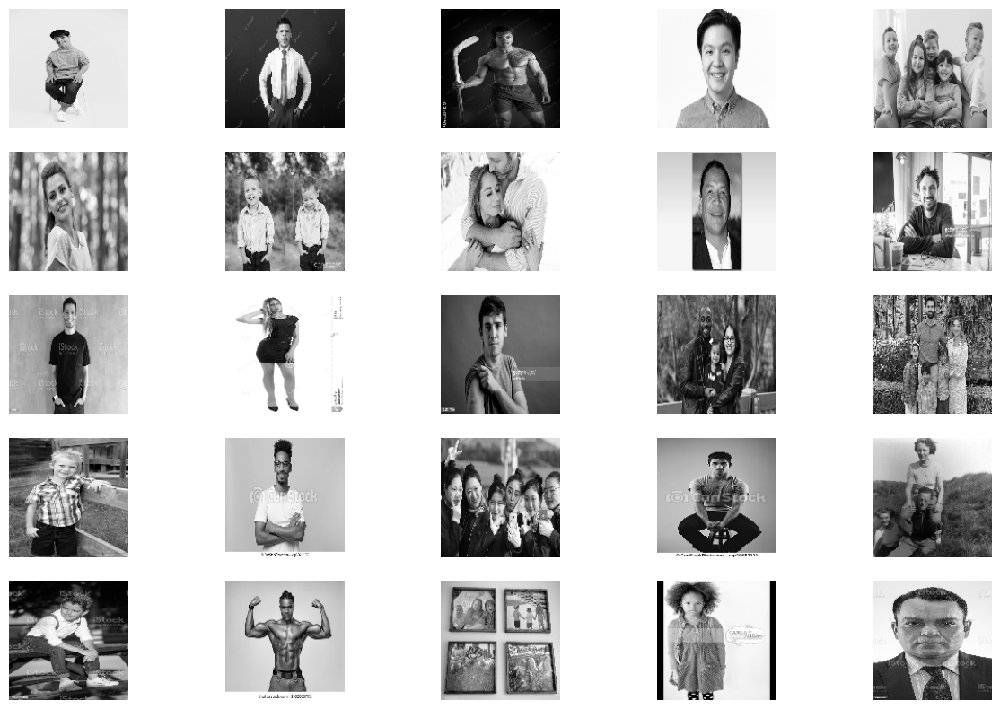

In [18]:
plt.figure(figsize=(15,10))
for i in range(25):
  plt.subplot(5, 5, i+1)
  plt.imshow(images[i], cmap='gray')
  plt.axis("off")

**Splitting and Model Building**

In [19]:
x_train, x_test, y_train, y_test = train_test_split(images, bbox, test_size=0.1, random_state=22)

**CNN Model**

In [20]:
model1 = Sequential()

model1.add(Conv2D(32, (3,3), input_shape=(128,128,1), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(64, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(128, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(Conv2D(256, (3,3), padding="same", activation="leaky_relu"))
model1.add(MaxPool2D(2,2))
model1.add(GlobalAveragePooling2D())
model1.add(Dense(256, activation="leaky_relu"))
model1.add(Dense(64, activation="leaky_relu"))
model1.add(Dense(48, activation="sigmoid"))

In [21]:
model1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 128, 128, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 64, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 32, 32, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 16, 16, 128)      0

In [22]:
class CustomCallbacks(keras.callbacks.Callback):
  def on_epoch_end(self,epoch,logs={}):
    prediction = model1.predict(x_test[0].reshape(1, 128, 128, 1))
    fig, ax = plt.subplots(1)
    ax.imshow(x_test[0])
    x1 = int(prediction[0][0]*128)
    y1 = int(prediction[0][1]*128)
    x2 = int(prediction[0][2]*128)
    y2 = int(prediction[0][3]*128)
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none")
    ax.add_patch(rect)
    plt.show()

In [23]:
model1.compile(optimizer = "adam", loss="binary_crossentropy")

Epoch 1/60
1/1 [==============================] - 0s 263ms/step


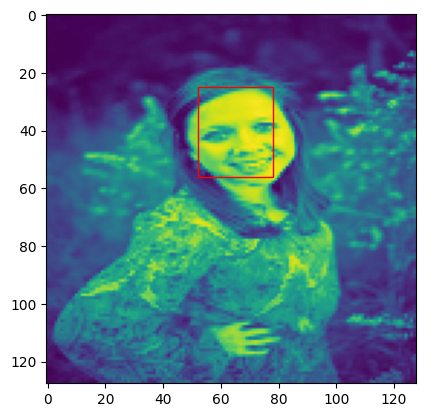

62/62 [==============================] - 9s 49ms/step - loss: 0.1969 - val_loss: 0.1241
Epoch 2/60
1/1 [==============================] - 0s 20ms/step


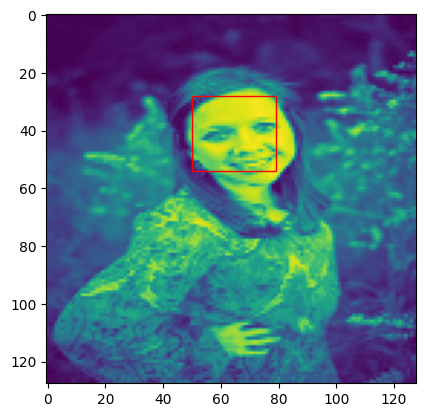

62/62 [==============================] - 2s 28ms/step - loss: 0.1321 - val_loss: 0.1230
Epoch 3/60
1/1 [==============================] - 0s 20ms/step


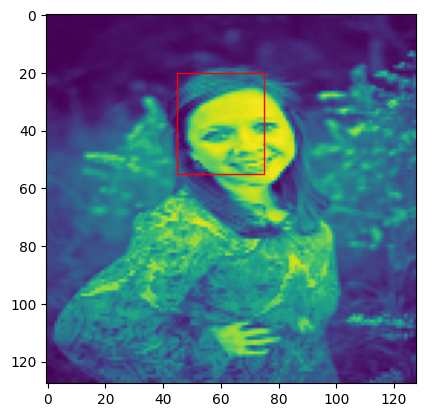

62/62 [==============================] - 2s 27ms/step - loss: 0.1295 - val_loss: 0.1126
Epoch 4/60
1/1 [==============================] - 0s 18ms/step


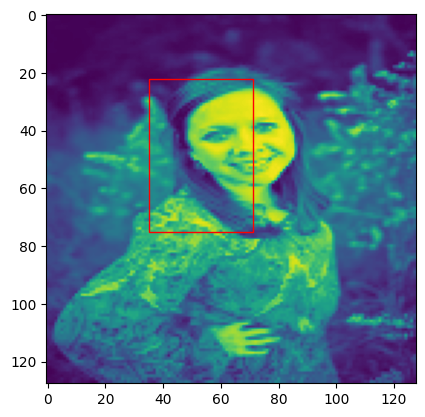

62/62 [==============================] - 2s 27ms/step - loss: 0.1224 - val_loss: 0.1157
Epoch 5/60
1/1 [==============================] - 0s 18ms/step


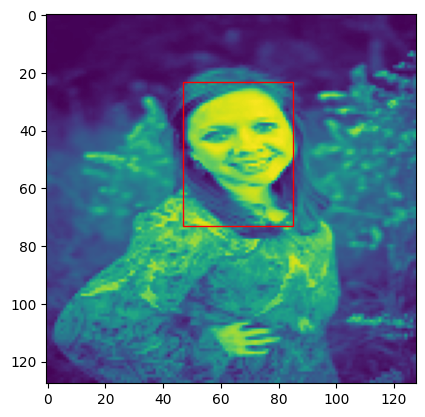

62/62 [==============================] - 2s 27ms/step - loss: 0.1213 - val_loss: 0.1099
Epoch 6/60
1/1 [==============================] - 0s 18ms/step


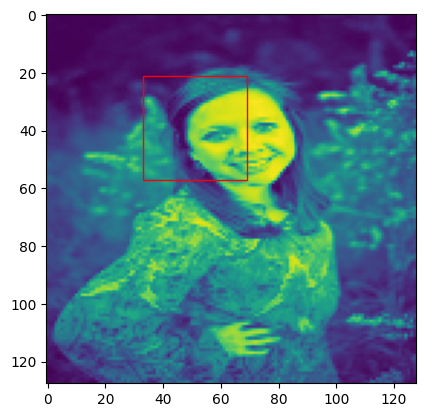

62/62 [==============================] - 2s 26ms/step - loss: 0.1208 - val_loss: 0.1099
Epoch 7/60
1/1 [==============================] - 0s 17ms/step


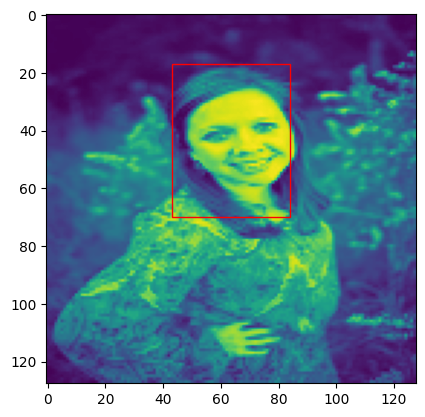

62/62 [==============================] - 2s 29ms/step - loss: 0.1179 - val_loss: 0.1081
Epoch 8/60
1/1 [==============================] - 0s 34ms/step


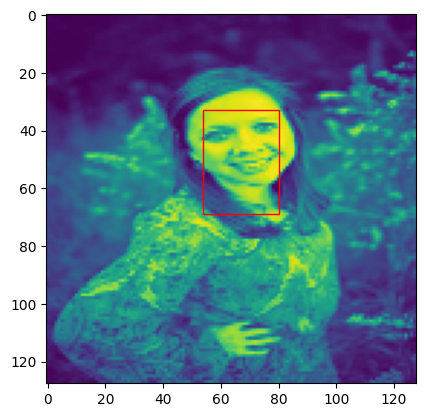

62/62 [==============================] - 2s 32ms/step - loss: 0.1171 - val_loss: 0.1123
Epoch 9/60
1/1 [==============================] - 0s 29ms/step


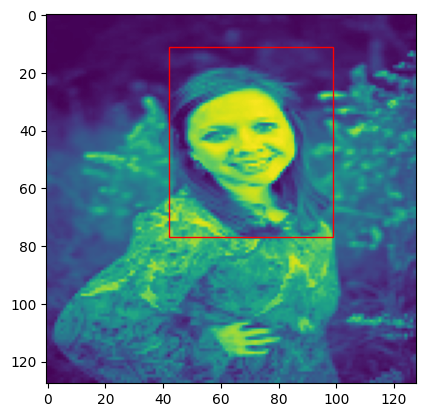

62/62 [==============================] - 2s 31ms/step - loss: 0.1186 - val_loss: 0.1115
Epoch 10/60
1/1 [==============================] - 0s 17ms/step


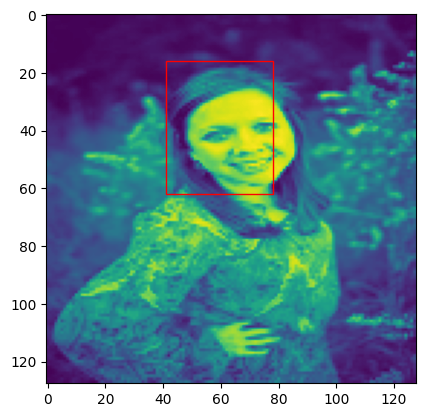

62/62 [==============================] - 2s 27ms/step - loss: 0.1177 - val_loss: 0.1088
Epoch 11/60
1/1 [==============================] - 0s 18ms/step


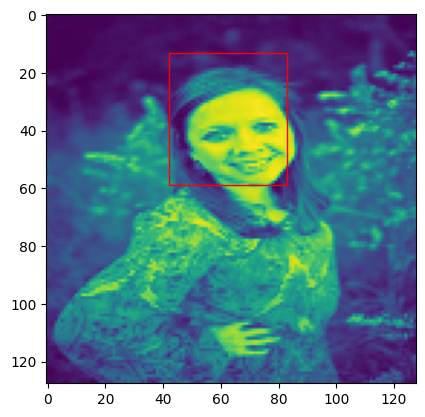

62/62 [==============================] - 2s 27ms/step - loss: 0.1145 - val_loss: 0.1116
Epoch 12/60
1/1 [==============================] - 0s 18ms/step


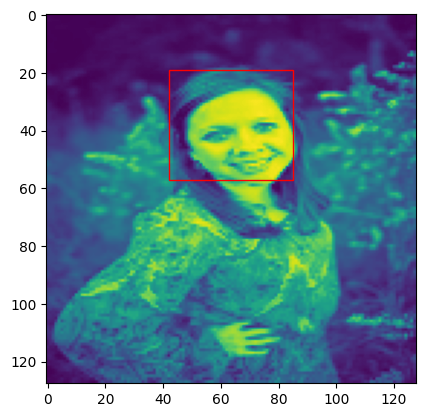

62/62 [==============================] - 2s 27ms/step - loss: 0.1156 - val_loss: 0.1099
Epoch 13/60
1/1 [==============================] - 0s 18ms/step


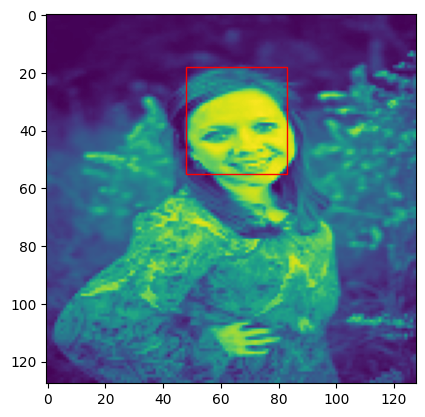

62/62 [==============================] - 2s 27ms/step - loss: 0.1133 - val_loss: 0.1078
Epoch 14/60
1/1 [==============================] - 0s 27ms/step


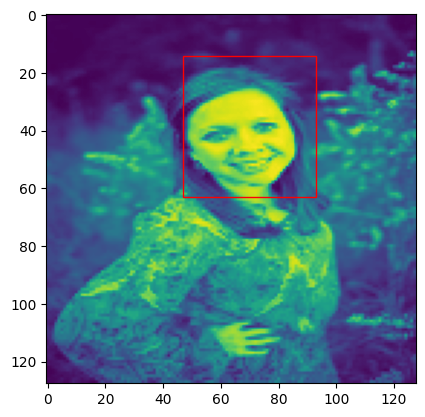

62/62 [==============================] - 2s 27ms/step - loss: 0.1126 - val_loss: 0.1082
Epoch 15/60
1/1 [==============================] - 0s 20ms/step


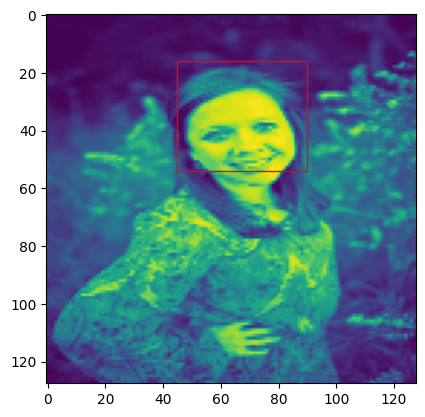

62/62 [==============================] - 2s 28ms/step - loss: 0.1126 - val_loss: 0.1076
Epoch 16/60
1/1 [==============================] - 0s 59ms/step


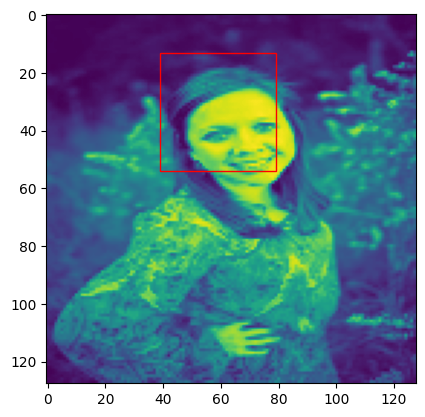

62/62 [==============================] - 2s 33ms/step - loss: 0.1111 - val_loss: 0.1132
Epoch 17/60
1/1 [==============================] - 0s 25ms/step


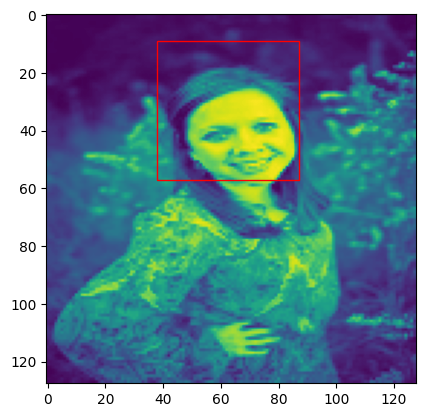

62/62 [==============================] - 2s 31ms/step - loss: 0.1120 - val_loss: 0.1070
Epoch 18/60
1/1 [==============================] - 0s 21ms/step


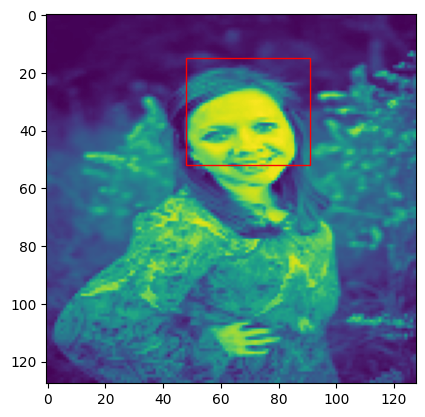

62/62 [==============================] - 2s 28ms/step - loss: 0.1115 - val_loss: 0.1080
Epoch 19/60
1/1 [==============================] - 0s 17ms/step


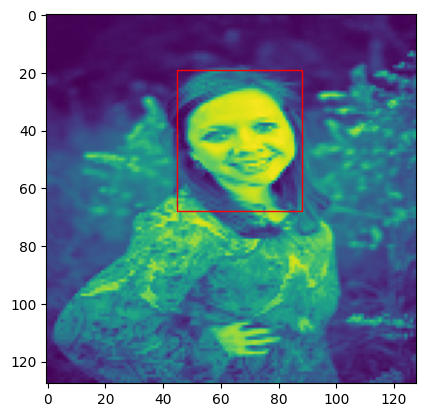

62/62 [==============================] - 2s 27ms/step - loss: 0.1103 - val_loss: 0.1066
Epoch 20/60
1/1 [==============================] - 0s 23ms/step


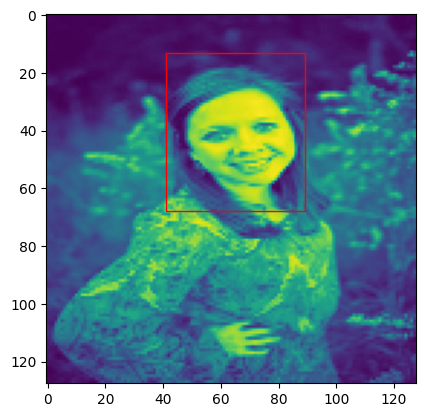

62/62 [==============================] - 2s 28ms/step - loss: 0.1085 - val_loss: 0.1059
Epoch 21/60
1/1 [==============================] - 0s 18ms/step


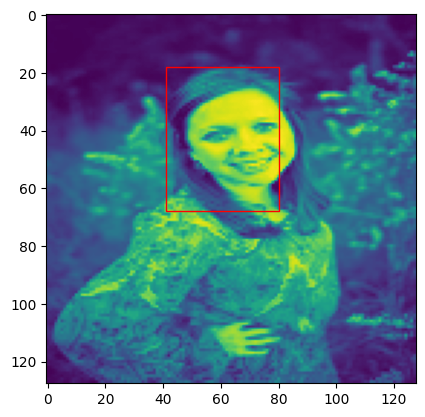

62/62 [==============================] - 2s 28ms/step - loss: 0.1072 - val_loss: 0.1049
Epoch 22/60
1/1 [==============================] - 0s 17ms/step


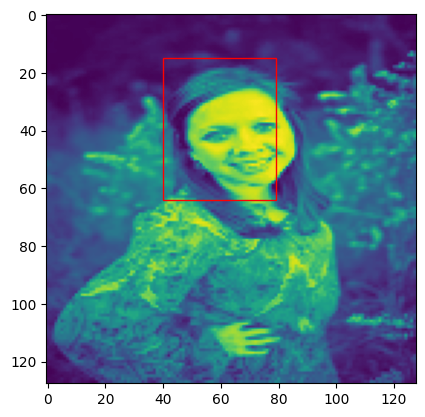

62/62 [==============================] - 2s 28ms/step - loss: 0.1066 - val_loss: 0.1039
Epoch 23/60
1/1 [==============================] - 0s 43ms/step


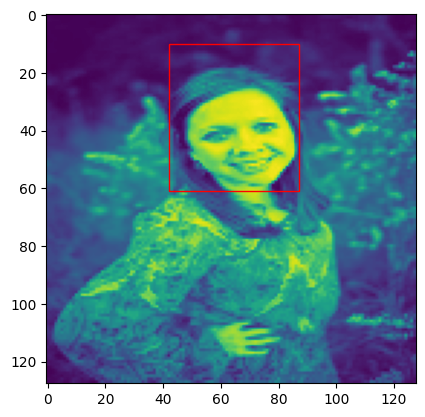

62/62 [==============================] - 2s 33ms/step - loss: 0.1057 - val_loss: 0.1042
Epoch 24/60
1/1 [==============================] - 0s 38ms/step


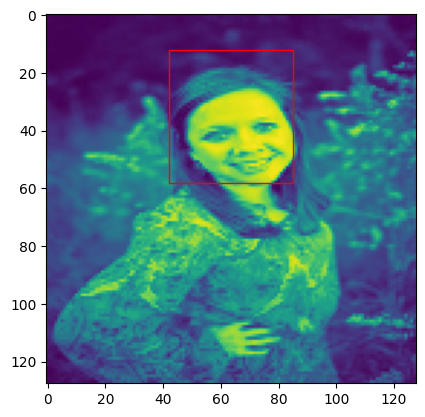

62/62 [==============================] - 2s 33ms/step - loss: 0.1062 - val_loss: 0.1031
Epoch 25/60
1/1 [==============================] - 0s 26ms/step


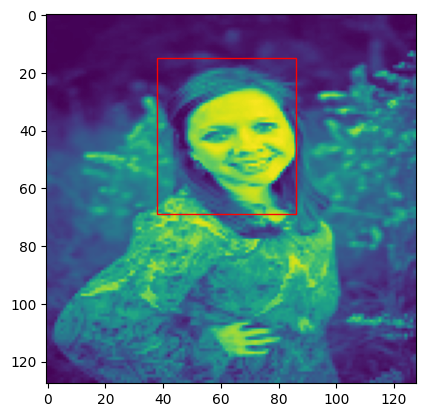

62/62 [==============================] - 2s 31ms/step - loss: 0.1043 - val_loss: 0.1057
Epoch 26/60
1/1 [==============================] - 0s 26ms/step


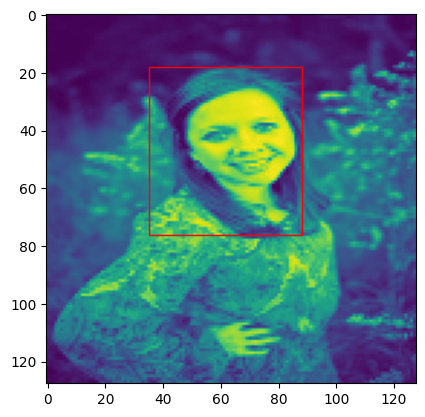

62/62 [==============================] - 2s 31ms/step - loss: 0.1049 - val_loss: 0.1020
Epoch 27/60
1/1 [==============================] - 0s 31ms/step


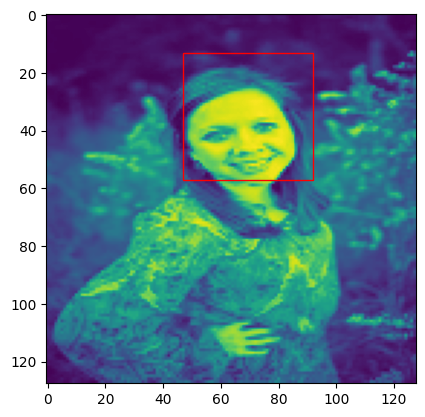

62/62 [==============================] - 2s 31ms/step - loss: 0.1061 - val_loss: 0.1030
Epoch 28/60
1/1 [==============================] - 0s 30ms/step


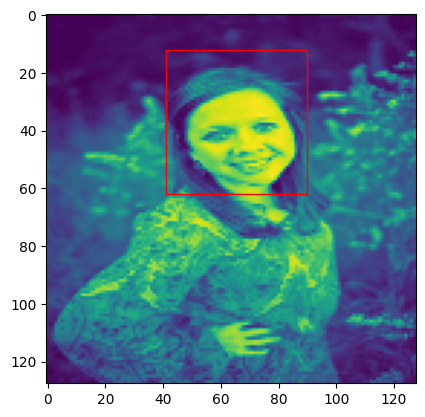

62/62 [==============================] - 2s 30ms/step - loss: 0.1033 - val_loss: 0.1051
Epoch 29/60
1/1 [==============================] - 0s 27ms/step


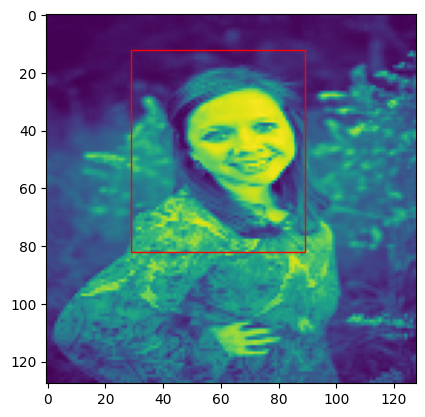

62/62 [==============================] - 2s 29ms/step - loss: 0.1039 - val_loss: 0.1050
Epoch 30/60
1/1 [==============================] - 0s 58ms/step


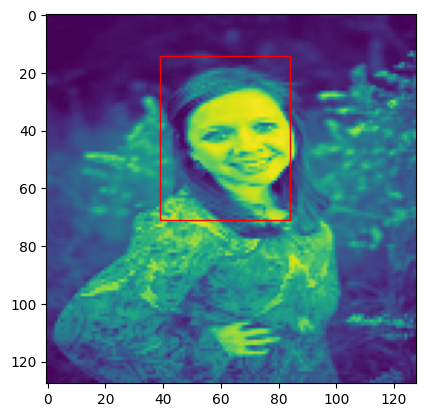

62/62 [==============================] - 2s 32ms/step - loss: 0.1037 - val_loss: 0.1057
Epoch 31/60
1/1 [==============================] - 0s 27ms/step


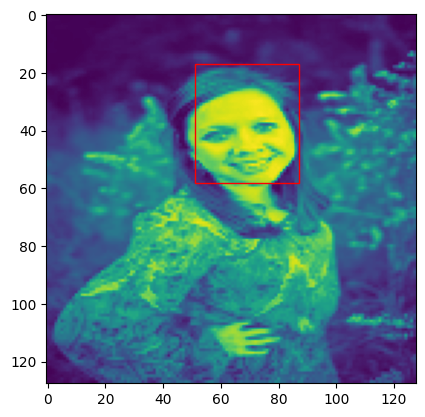

62/62 [==============================] - 2s 33ms/step - loss: 0.1031 - val_loss: 0.1046
Epoch 32/60
1/1 [==============================] - 0s 24ms/step


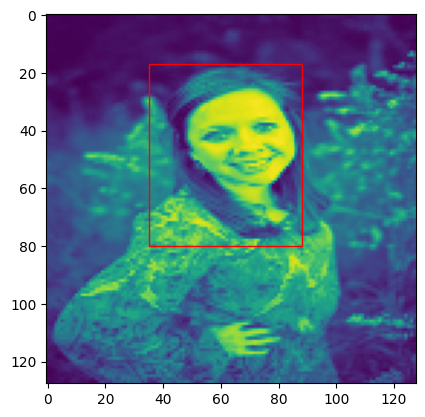

62/62 [==============================] - 2s 32ms/step - loss: 0.1030 - val_loss: 0.1040
Epoch 33/60
1/1 [==============================] - 0s 25ms/step


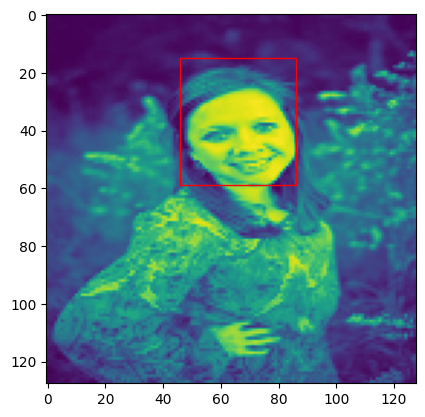

62/62 [==============================] - 2s 31ms/step - loss: 0.1021 - val_loss: 0.1010
Epoch 34/60
1/1 [==============================] - 0s 24ms/step


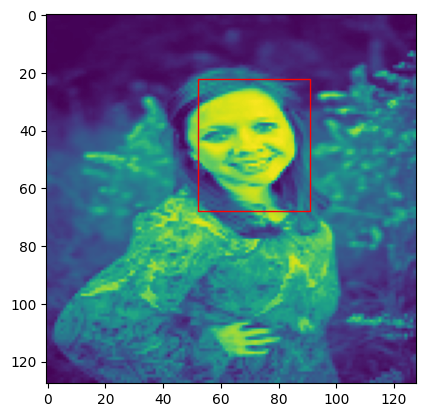

62/62 [==============================] - 2s 29ms/step - loss: 0.1012 - val_loss: 0.1026
Epoch 35/60
1/1 [==============================] - 0s 30ms/step


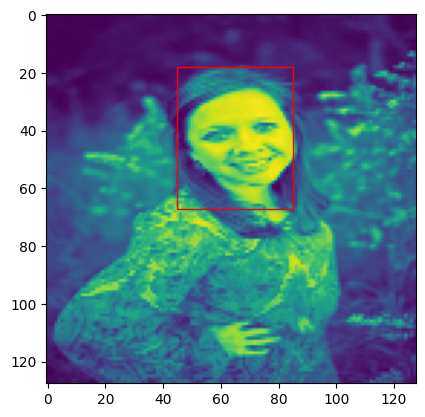

62/62 [==============================] - 2s 29ms/step - loss: 0.1022 - val_loss: 0.1009
Epoch 36/60
1/1 [==============================] - 0s 27ms/step


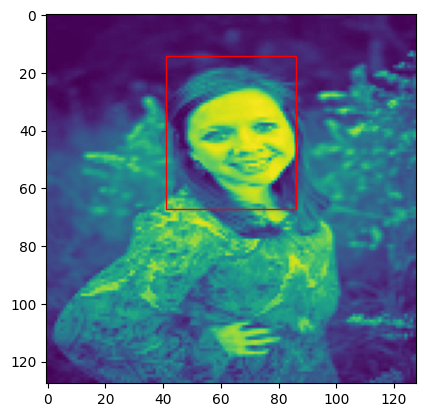

62/62 [==============================] - 2s 29ms/step - loss: 0.1014 - val_loss: 0.1009
Epoch 37/60
1/1 [==============================] - 0s 28ms/step


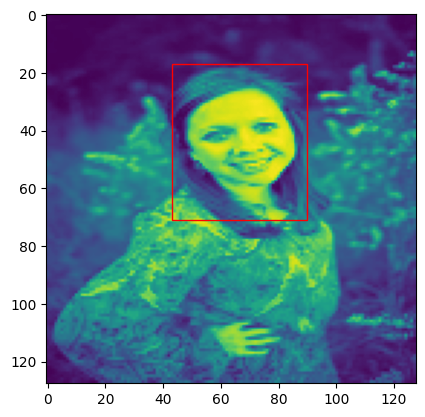

62/62 [==============================] - 2s 30ms/step - loss: 0.0995 - val_loss: 0.1007
Epoch 38/60
1/1 [==============================] - 0s 54ms/step


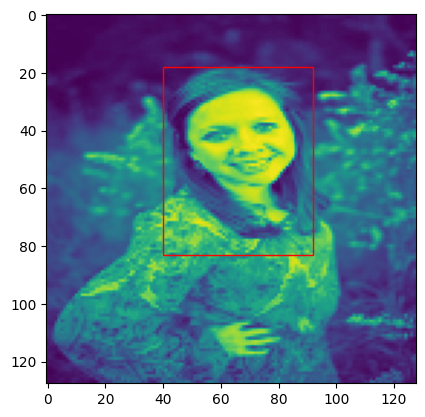

62/62 [==============================] - 2s 33ms/step - loss: 0.1000 - val_loss: 0.1039
Epoch 39/60
1/1 [==============================] - 0s 29ms/step


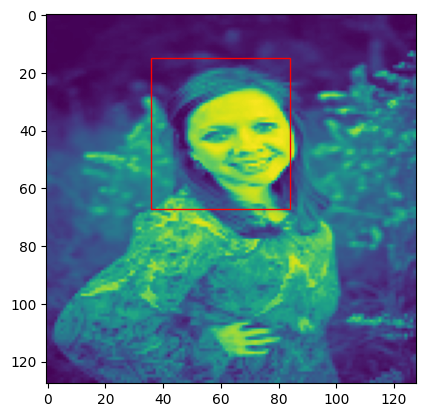

62/62 [==============================] - 3s 41ms/step - loss: 0.1011 - val_loss: 0.1016
Epoch 40/60
1/1 [==============================] - 0s 131ms/step


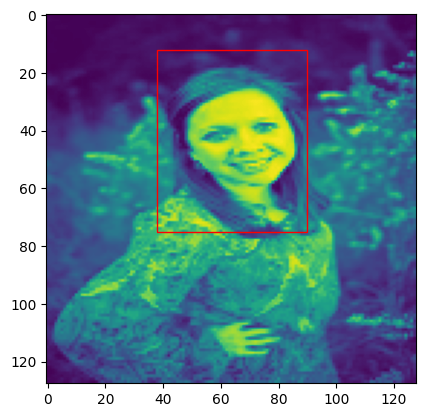

62/62 [==============================] - 3s 49ms/step - loss: 0.0988 - val_loss: 0.0993
Epoch 41/60
1/1 [==============================] - 0s 27ms/step


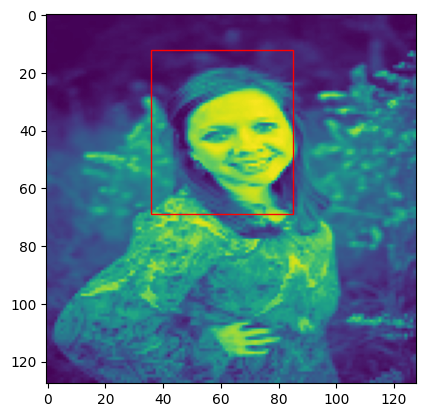

62/62 [==============================] - 2s 29ms/step - loss: 0.0983 - val_loss: 0.0993
Epoch 42/60
1/1 [==============================] - 0s 36ms/step


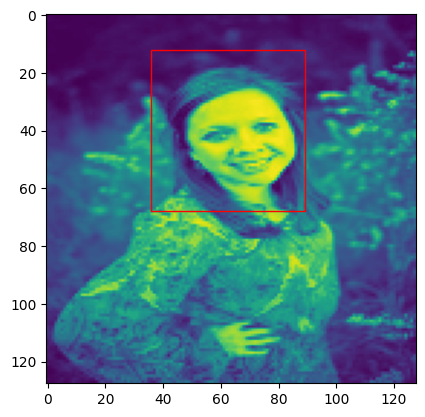

62/62 [==============================] - 2s 29ms/step - loss: 0.0997 - val_loss: 0.0990
Epoch 43/60
1/1 [==============================] - 0s 39ms/step


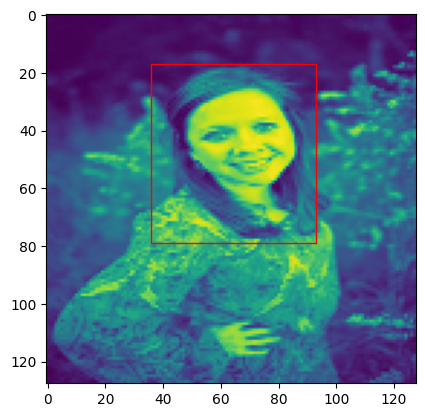

62/62 [==============================] - 2s 30ms/step - loss: 0.1003 - val_loss: 0.0988
Epoch 44/60
1/1 [==============================] - 0s 54ms/step


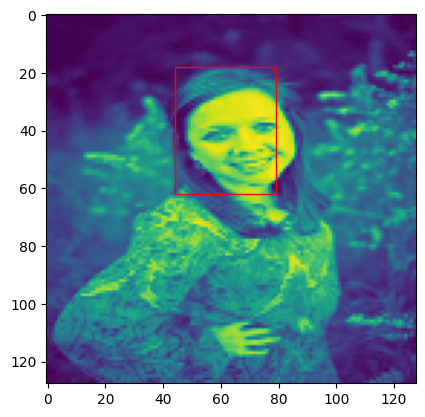

62/62 [==============================] - 2s 34ms/step - loss: 0.0990 - val_loss: 0.0999
Epoch 45/60
1/1 [==============================] - 0s 29ms/step


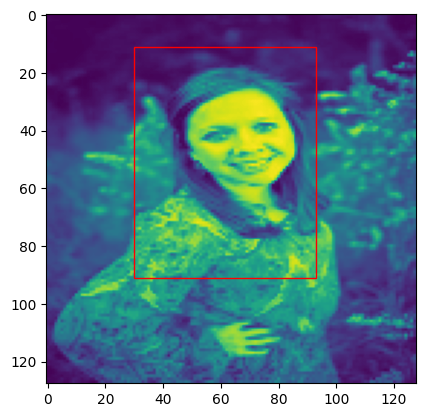

62/62 [==============================] - 2s 36ms/step - loss: 0.0969 - val_loss: 0.0993
Epoch 46/60
1/1 [==============================] - 0s 30ms/step


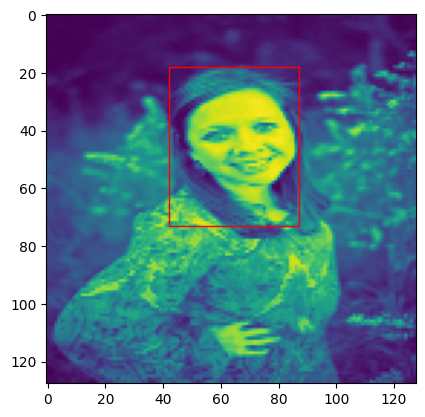

62/62 [==============================] - 2s 30ms/step - loss: 0.0957 - val_loss: 0.0991
Epoch 47/60
1/1 [==============================] - 0s 31ms/step


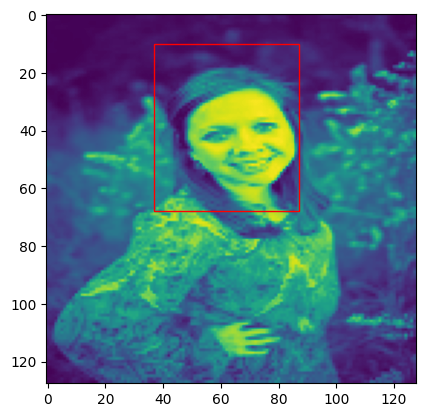

62/62 [==============================] - 2s 30ms/step - loss: 0.0968 - val_loss: 0.0981
Epoch 48/60
1/1 [==============================] - 0s 36ms/step


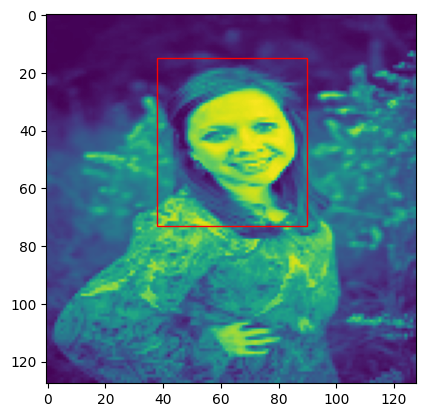

62/62 [==============================] - 2s 32ms/step - loss: 0.0949 - val_loss: 0.0994
Epoch 49/60
1/1 [==============================] - 0s 28ms/step


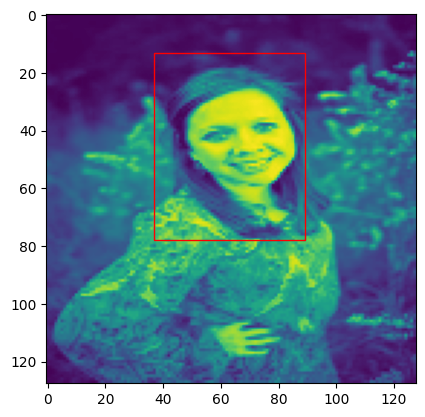

62/62 [==============================] - 2s 29ms/step - loss: 0.0948 - val_loss: 0.1068
Epoch 50/60
1/1 [==============================] - 0s 42ms/step


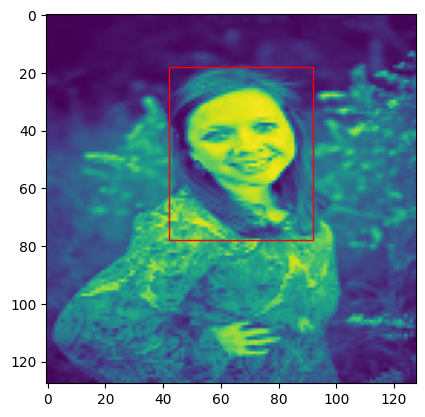

62/62 [==============================] - 2s 31ms/step - loss: 0.0946 - val_loss: 0.0981
Epoch 51/60
1/1 [==============================] - 0s 59ms/step


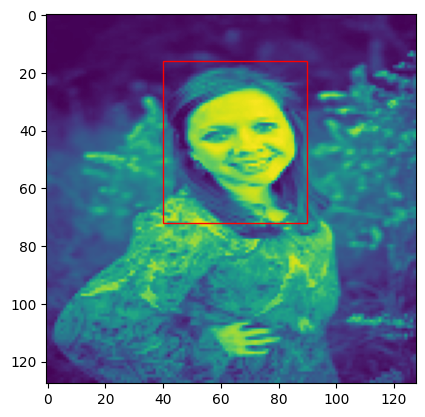

62/62 [==============================] - 2s 34ms/step - loss: 0.0937 - val_loss: 0.0997
Epoch 52/60
1/1 [==============================] - 0s 31ms/step


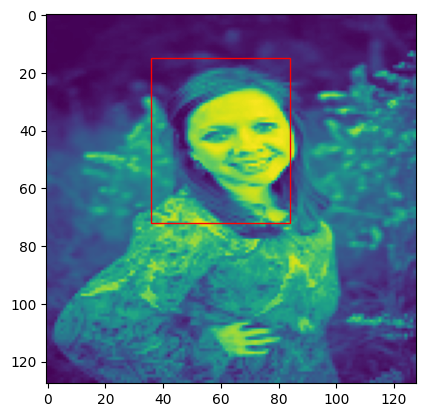

62/62 [==============================] - 2s 30ms/step - loss: 0.0940 - val_loss: 0.0972
Epoch 53/60
1/1 [==============================] - 0s 32ms/step


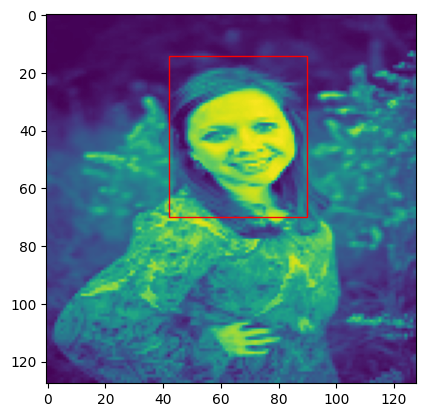

62/62 [==============================] - 2s 30ms/step - loss: 0.0921 - val_loss: 0.0976
Epoch 54/60
1/1 [==============================] - 0s 28ms/step


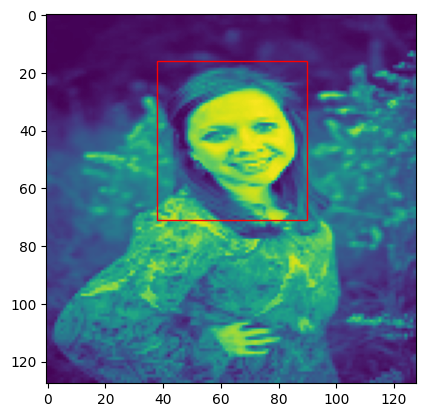

62/62 [==============================] - 2s 30ms/step - loss: 0.0915 - val_loss: 0.0986
Epoch 55/60
1/1 [==============================] - 0s 27ms/step


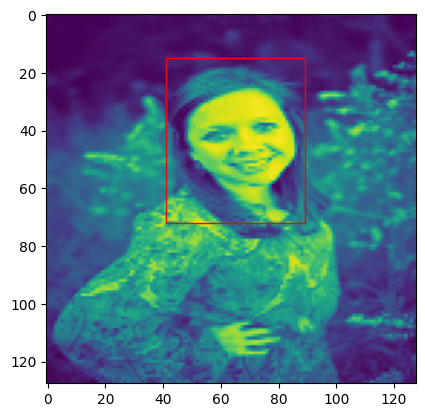

62/62 [==============================] - 2s 31ms/step - loss: 0.0913 - val_loss: 0.1013
Epoch 56/60
1/1 [==============================] - 0s 31ms/step


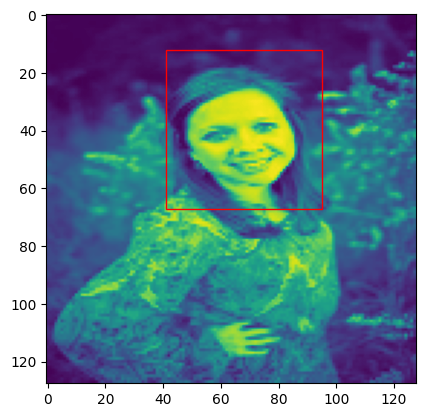

62/62 [==============================] - 2s 30ms/step - loss: 0.0940 - val_loss: 0.1062
Epoch 57/60
1/1 [==============================] - 0s 25ms/step


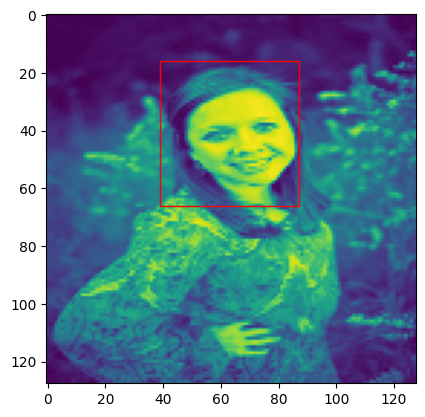

62/62 [==============================] - 2s 29ms/step - loss: 0.0919 - val_loss: 0.1002
Epoch 58/60
1/1 [==============================] - 0s 35ms/step


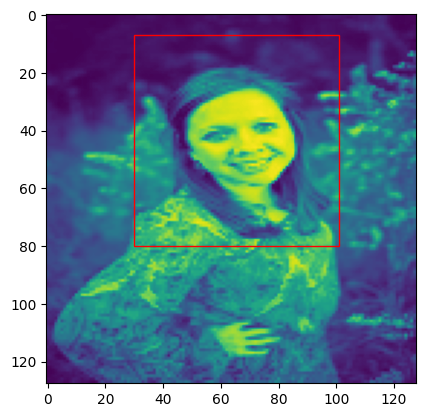

62/62 [==============================] - 2s 34ms/step - loss: 0.0913 - val_loss: 0.1014
Epoch 59/60
1/1 [==============================] - 0s 28ms/step


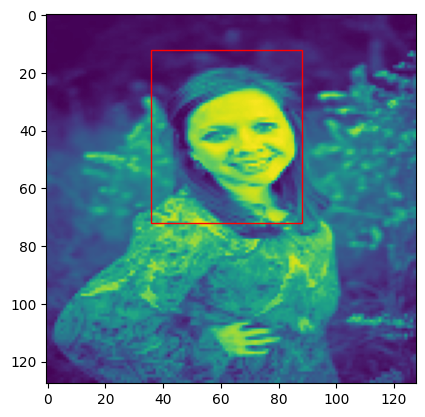

62/62 [==============================] - 2s 31ms/step - loss: 0.0902 - val_loss: 0.0991
Epoch 60/60
1/1 [==============================] - 0s 25ms/step


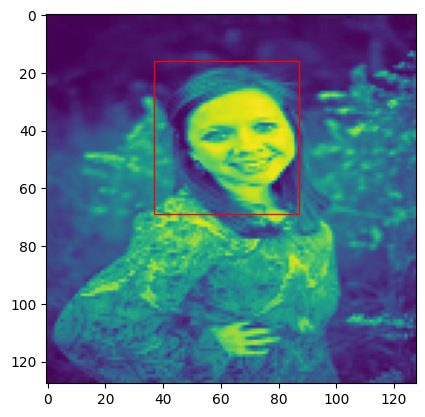

62/62 [==============================] - 2s 29ms/step - loss: 0.0891 - val_loss: 0.0975


In [24]:
history1 = model1.fit(x_train, y_train, validation_data=(x_test, y_test), epochs=60, callbacks=[CustomCallbacks()])

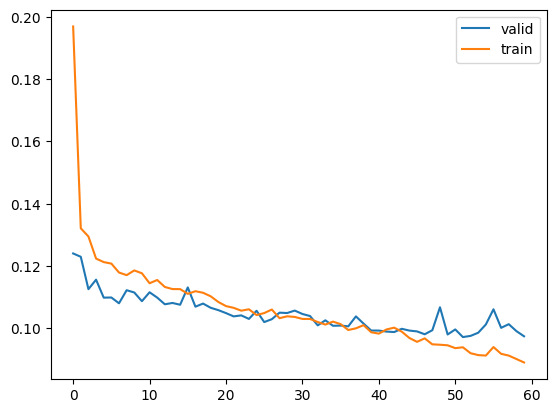

In [25]:
plt.plot(history1.history["val_loss"])
plt.plot(history1.history["loss"])
plt.legend(["valid", "train"])
plt.show()

In [26]:
y_pred = model1.predict(x_test)

7/7 [==============================] - 0s 8ms/step


In [27]:
print(f"mean absolute error is {mean_absolute_error(y_pred, y_test)}")

mean absolute error is 0.02692264133535006


**CNN Model with Dropout and BatchNormalization Layer**

In [28]:
model2 = Sequential()

model2.add(Conv2D(32, (3,3), input_shape=(128,128,1), activation="relu"))
model2.add(Dropout(0.1))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(64, (3,3), activation="relu"))
model2.add(Dropout(0.1))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(128, (3,3), activation="relu"))
model2.add(Dropout(0.2))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(Conv2D(256, (3,3), activation="relu"))
model2.add(Dropout(0.3))
model2.add(MaxPool2D(2,2))
model2.add(BatchNormalization())
model2.add(GlobalAveragePooling2D())
model2.add(Dense(256, activation="leaky_relu"))
model2.add(Dense(48, activation="sigmoid"))

In [29]:
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 126, 126, 32)      320       
                                                                 
 dropout (Dropout)           (None, 126, 126, 32)      0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 63, 63, 32)       0         
 2D)                                                             
                                                                 
 batch_normalization (BatchN  (None, 63, 63, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_5 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 dropout_1 (Dropout)         (None, 61, 61, 64)       

In [30]:
class CustomCallbacks2(keras.callbacks.Callback):
  def on_epoch_end(self,epoch,logs={}):
    prediction = model2.predict(x_test[0].reshape(1, 128, 128, 1))
    fig, ax = plt.subplots(1)
    ax.imshow(x_test[0])
    x1 = int(prediction[0][0]*128)
    y1 = int(prediction[0][1]*128)
    x2 = int(prediction[0][2]*128)
    y2 = int(prediction[0][3]*128)
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none")
    ax.add_patch(rect)
    plt.show()

In [31]:
model2.compile(optimizer="adam", loss="binary_crossentropy")

Epoch 1/60
1/1 [==============================] - 0s 303ms/step


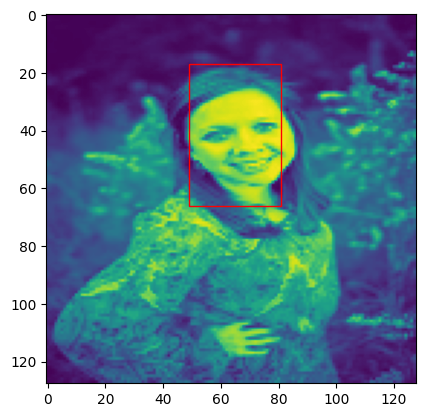

248/248 [==============================] - 10s 20ms/step - loss: 0.1531 - val_loss: 0.2044
Epoch 2/60
1/1 [==============================] - 0s 27ms/step


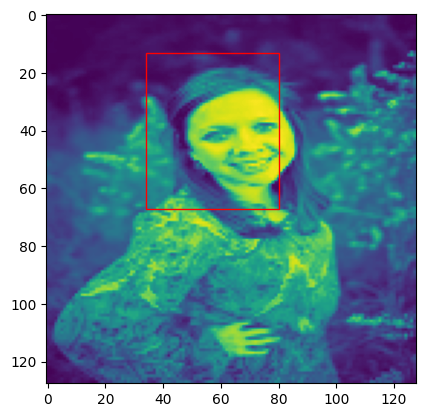

248/248 [==============================] - 3s 14ms/step - loss: 0.1242 - val_loss: 0.1420
Epoch 3/60
1/1 [==============================] - 0s 51ms/step


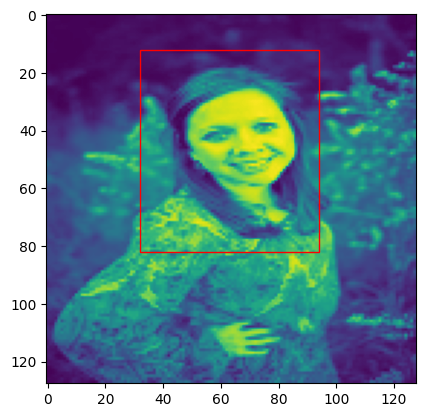

248/248 [==============================] - 3s 14ms/step - loss: 0.1182 - val_loss: 0.1420
Epoch 4/60
1/1 [==============================] - 0s 26ms/step


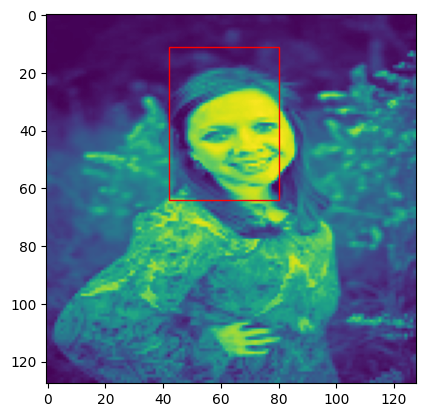

248/248 [==============================] - 3s 14ms/step - loss: 0.1170 - val_loss: 0.1231
Epoch 5/60
1/1 [==============================] - 0s 61ms/step


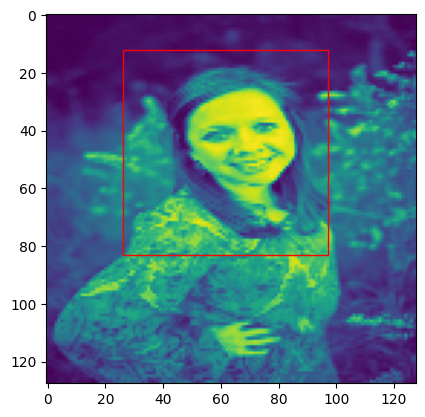

248/248 [==============================] - 4s 16ms/step - loss: 0.1149 - val_loss: 0.1213
Epoch 6/60
1/1 [==============================] - 0s 26ms/step


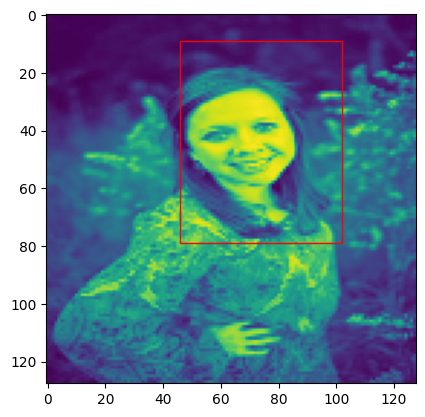

248/248 [==============================] - 3s 14ms/step - loss: 0.1147 - val_loss: 0.1188
Epoch 7/60
1/1 [==============================] - 0s 28ms/step


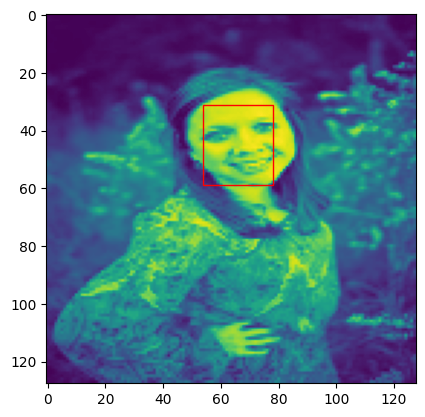

248/248 [==============================] - 3s 14ms/step - loss: 0.1120 - val_loss: 0.1148
Epoch 8/60
1/1 [==============================] - 0s 26ms/step


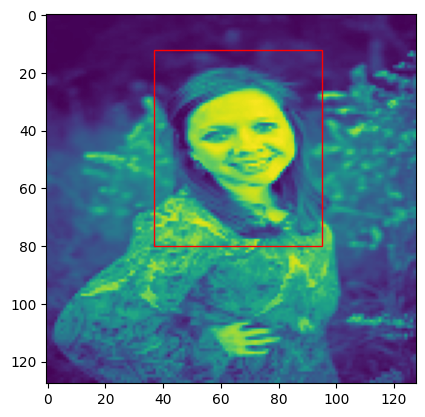

248/248 [==============================] - 3s 13ms/step - loss: 0.1101 - val_loss: 0.1144
Epoch 9/60
1/1 [==============================] - 0s 56ms/step


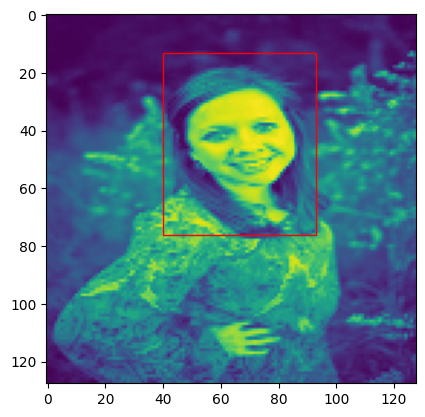

248/248 [==============================] - 4s 16ms/step - loss: 0.1109 - val_loss: 0.1129
Epoch 10/60
1/1 [==============================] - 0s 27ms/step


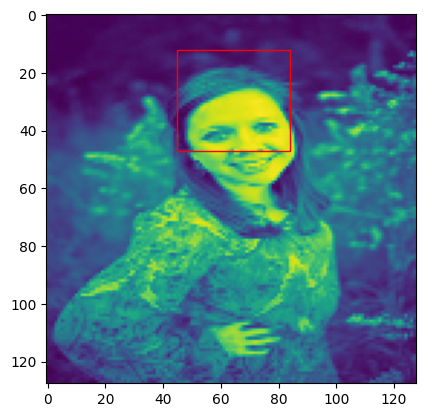

248/248 [==============================] - 3s 14ms/step - loss: 0.1100 - val_loss: 0.1351
Epoch 11/60
1/1 [==============================] - 0s 27ms/step


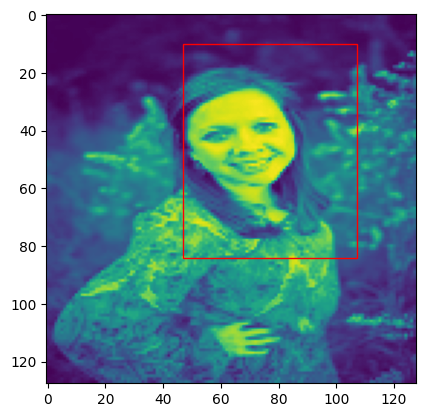

248/248 [==============================] - 3s 13ms/step - loss: 0.1075 - val_loss: 0.1244
Epoch 12/60
1/1 [==============================] - 0s 27ms/step


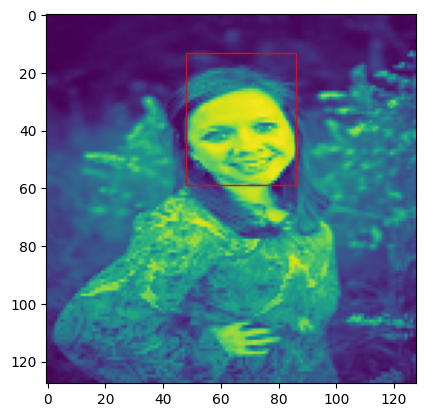

248/248 [==============================] - 3s 13ms/step - loss: 0.1077 - val_loss: 0.1247
Epoch 13/60
1/1 [==============================] - 0s 58ms/step


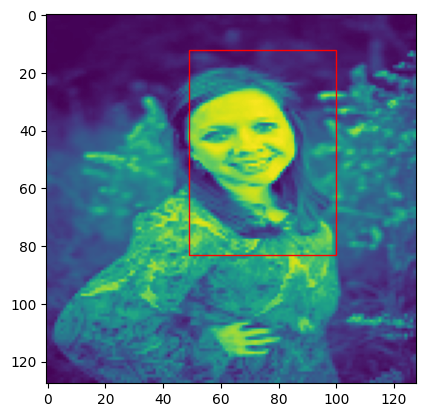

248/248 [==============================] - 4s 15ms/step - loss: 0.1069 - val_loss: 0.1153
Epoch 14/60
1/1 [==============================] - 0s 29ms/step


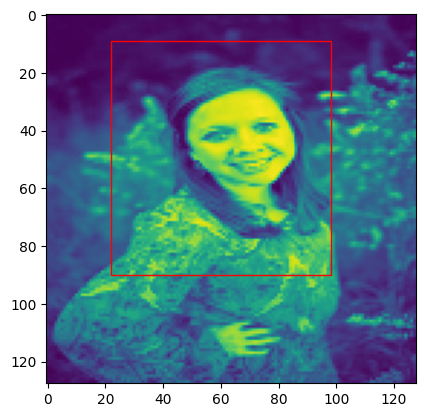

248/248 [==============================] - 3s 14ms/step - loss: 0.1057 - val_loss: 0.1172
Epoch 15/60
1/1 [==============================] - 0s 26ms/step


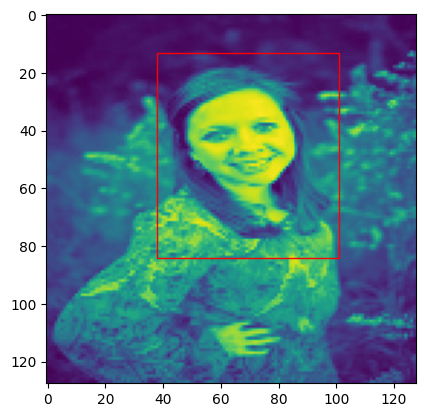

248/248 [==============================] - 3s 13ms/step - loss: 0.1047 - val_loss: 0.1041
Epoch 16/60
1/1 [==============================] - 0s 34ms/step


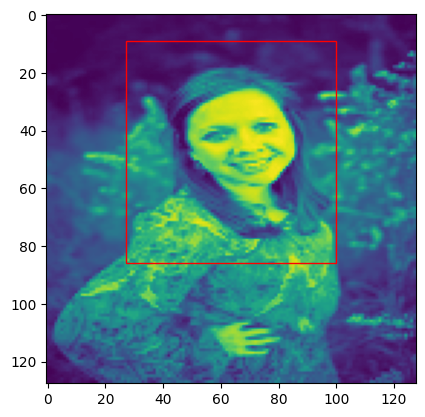

248/248 [==============================] - 3s 13ms/step - loss: 0.1046 - val_loss: 0.1377
Epoch 17/60
1/1 [==============================] - 0s 42ms/step


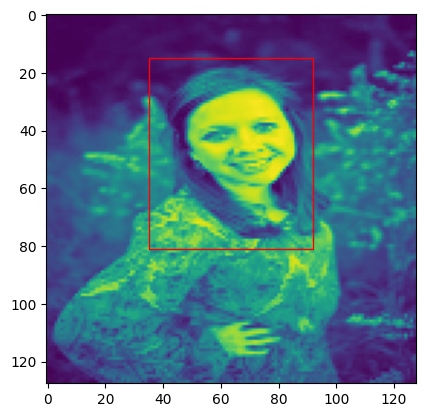

248/248 [==============================] - 4s 15ms/step - loss: 0.1026 - val_loss: 0.1102
Epoch 18/60
1/1 [==============================] - 0s 31ms/step


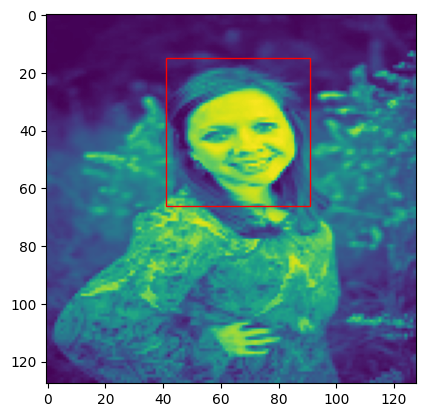

248/248 [==============================] - 3s 14ms/step - loss: 0.1029 - val_loss: 0.1283
Epoch 19/60
1/1 [==============================] - 0s 27ms/step


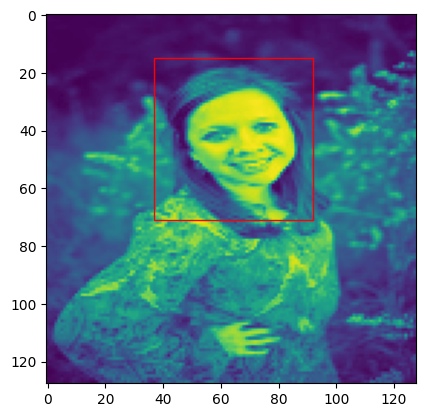

248/248 [==============================] - 3s 13ms/step - loss: 0.1003 - val_loss: 0.1058
Epoch 20/60
1/1 [==============================] - 0s 27ms/step


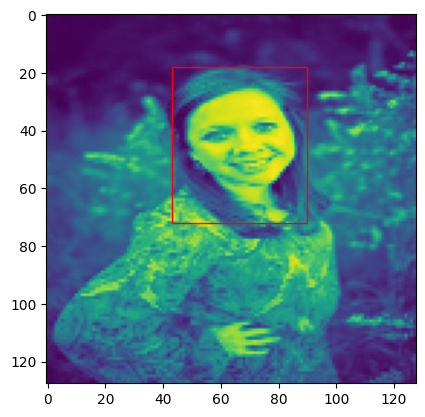

248/248 [==============================] - 3s 13ms/step - loss: 0.1002 - val_loss: 0.1042
Epoch 21/60
1/1 [==============================] - 0s 31ms/step


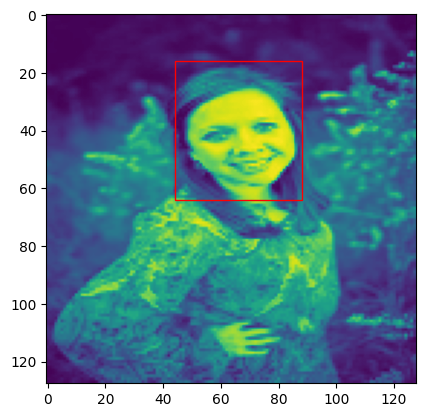

248/248 [==============================] - 4s 16ms/step - loss: 0.1004 - val_loss: 0.1142
Epoch 22/60
1/1 [==============================] - 0s 39ms/step


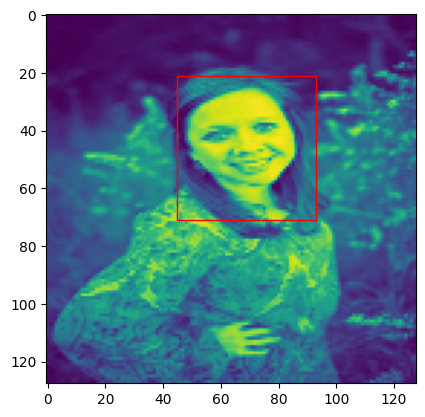

248/248 [==============================] - 4s 14ms/step - loss: 0.1009 - val_loss: 0.1052
Epoch 23/60
1/1 [==============================] - 0s 29ms/step


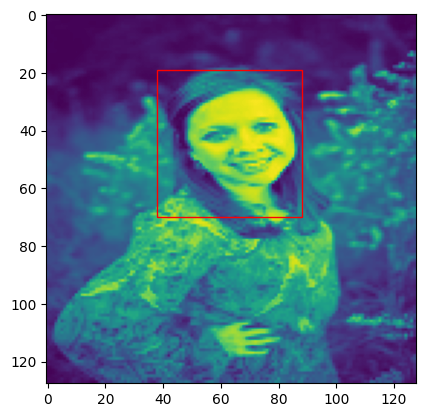

248/248 [==============================] - 3s 13ms/step - loss: 0.0980 - val_loss: 0.1128
Epoch 24/60
1/1 [==============================] - 0s 29ms/step


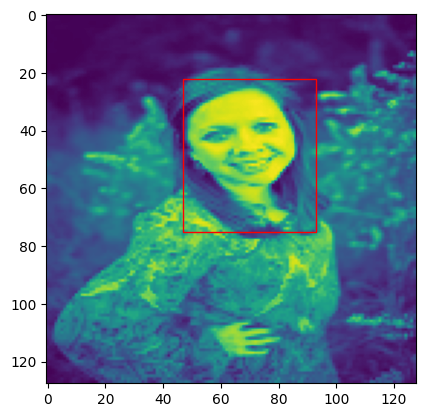

248/248 [==============================] - 3s 13ms/step - loss: 0.0985 - val_loss: 0.1300
Epoch 25/60
1/1 [==============================] - 0s 35ms/step


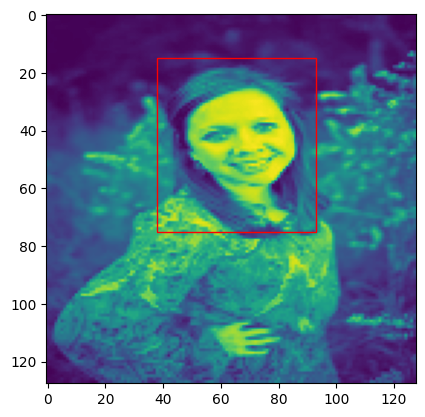

248/248 [==============================] - 4s 15ms/step - loss: 0.0977 - val_loss: 0.1083
Epoch 26/60
1/1 [==============================] - 0s 32ms/step


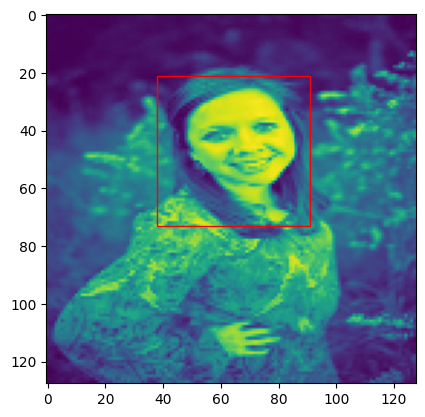

248/248 [==============================] - 4s 14ms/step - loss: 0.0953 - val_loss: 0.1243
Epoch 27/60
1/1 [==============================] - 0s 26ms/step


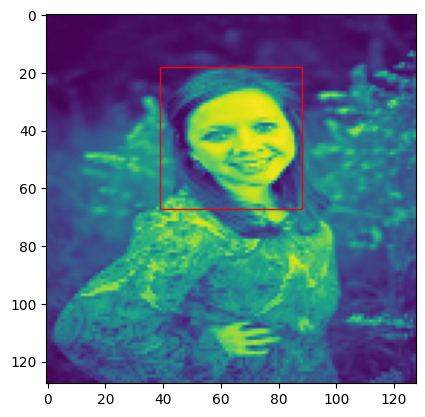

248/248 [==============================] - 3s 13ms/step - loss: 0.0941 - val_loss: 0.1271
Epoch 28/60
1/1 [==============================] - 0s 31ms/step


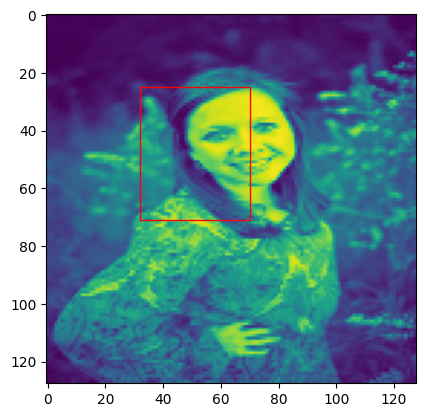

248/248 [==============================] - 3s 14ms/step - loss: 0.0945 - val_loss: 0.1008
Epoch 29/60
1/1 [==============================] - 0s 37ms/step


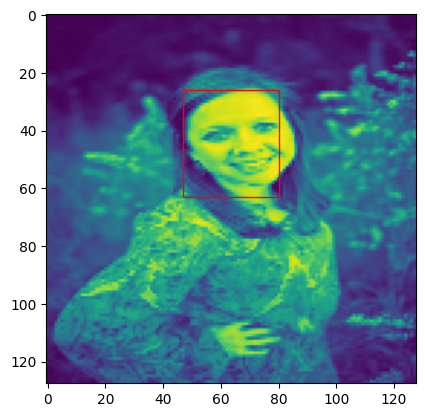

248/248 [==============================] - 4s 15ms/step - loss: 0.0928 - val_loss: 0.1284
Epoch 30/60
1/1 [==============================] - 0s 29ms/step


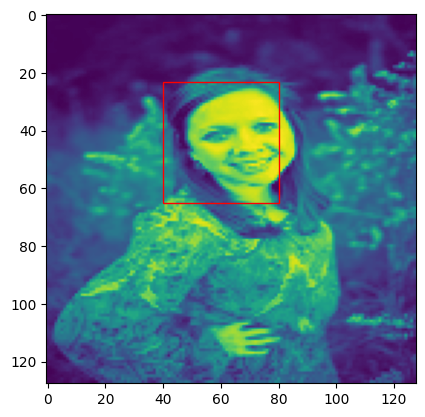

248/248 [==============================] - 3s 14ms/step - loss: 0.0915 - val_loss: 0.1050
Epoch 31/60
1/1 [==============================] - 0s 26ms/step


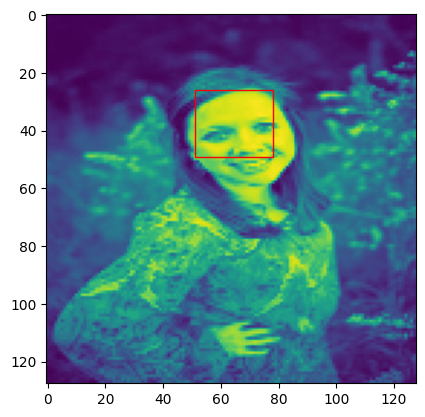

248/248 [==============================] - 3s 13ms/step - loss: 0.0910 - val_loss: 0.1043
Epoch 32/60
1/1 [==============================] - 0s 29ms/step


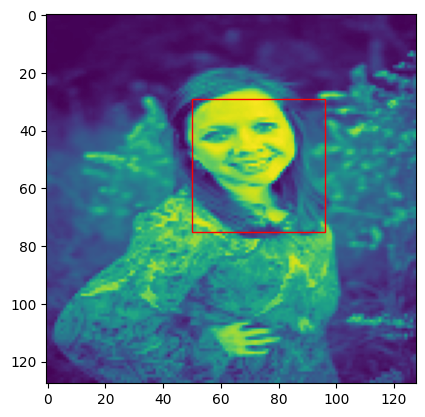

248/248 [==============================] - 3s 13ms/step - loss: 0.0900 - val_loss: 0.1227
Epoch 33/60
1/1 [==============================] - 0s 66ms/step


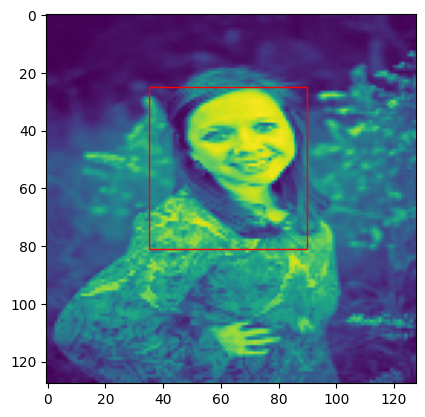

248/248 [==============================] - 4s 16ms/step - loss: 0.0895 - val_loss: 0.1259
Epoch 34/60
1/1 [==============================] - 0s 30ms/step


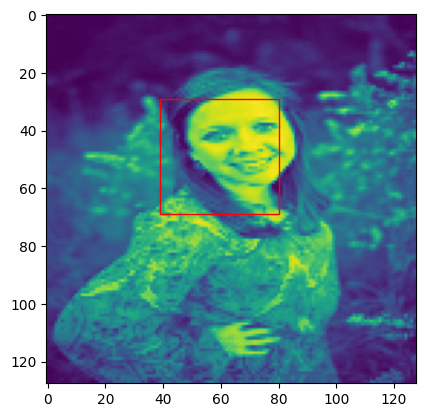

248/248 [==============================] - 4s 14ms/step - loss: 0.0879 - val_loss: 0.1180
Epoch 35/60
1/1 [==============================] - 0s 26ms/step


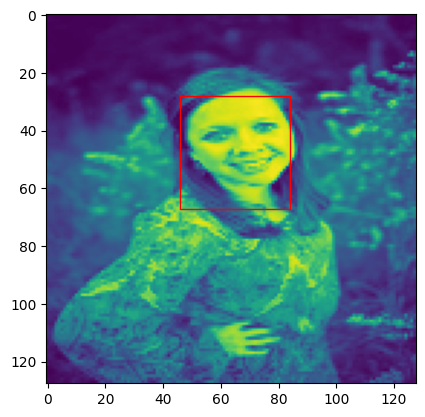

248/248 [==============================] - 3s 14ms/step - loss: 0.0875 - val_loss: 0.1338
Epoch 36/60
1/1 [==============================] - 0s 26ms/step


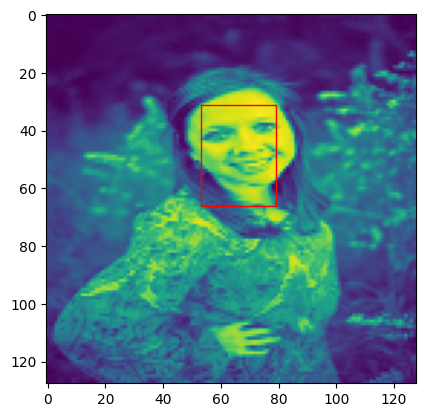

248/248 [==============================] - 3s 13ms/step - loss: 0.0857 - val_loss: 0.1232
Epoch 37/60
1/1 [==============================] - 0s 26ms/step


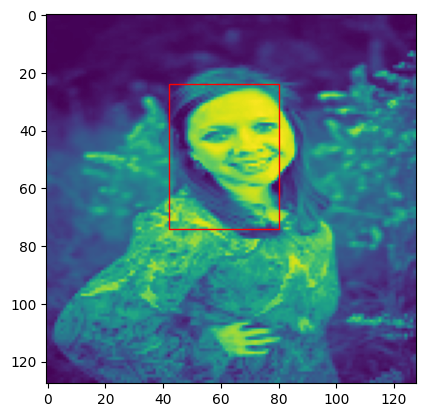

248/248 [==============================] - 4s 14ms/step - loss: 0.0846 - val_loss: 0.1492
Epoch 38/60
1/1 [==============================] - 0s 27ms/step


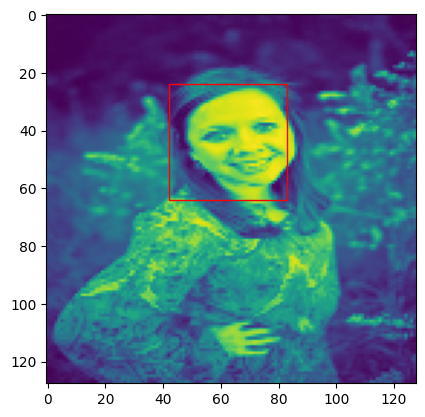

248/248 [==============================] - 3s 14ms/step - loss: 0.0853 - val_loss: 0.1234
Epoch 39/60
1/1 [==============================] - 0s 29ms/step


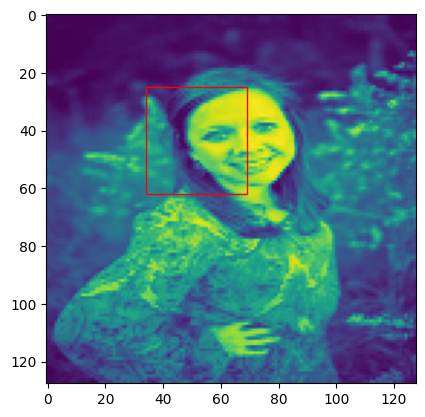

248/248 [==============================] - 3s 13ms/step - loss: 0.0839 - val_loss: 0.1126
Epoch 40/60
1/1 [==============================] - 0s 28ms/step


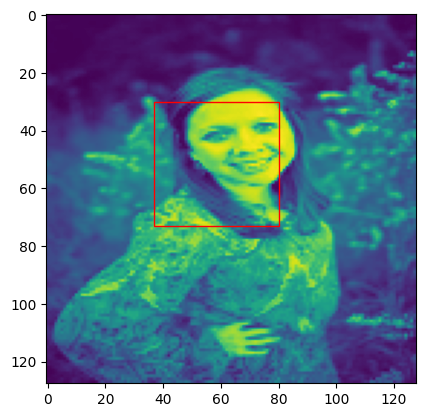

248/248 [==============================] - 3s 13ms/step - loss: 0.0843 - val_loss: 0.1270
Epoch 41/60
1/1 [==============================] - 0s 59ms/step


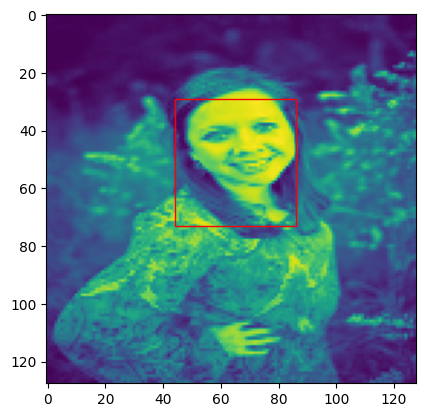

248/248 [==============================] - 4s 15ms/step - loss: 0.0826 - val_loss: 0.1115
Epoch 42/60
1/1 [==============================] - 0s 30ms/step


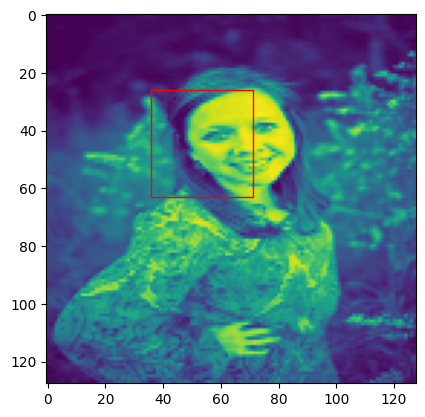

248/248 [==============================] - 3s 14ms/step - loss: 0.0830 - val_loss: 0.1227
Epoch 43/60
1/1 [==============================] - 0s 28ms/step


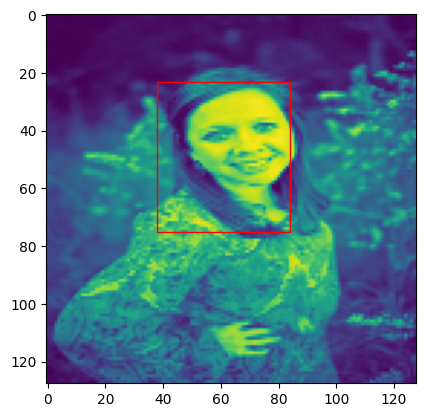

248/248 [==============================] - 3s 13ms/step - loss: 0.0811 - val_loss: 0.1372
Epoch 44/60
1/1 [==============================] - 0s 26ms/step


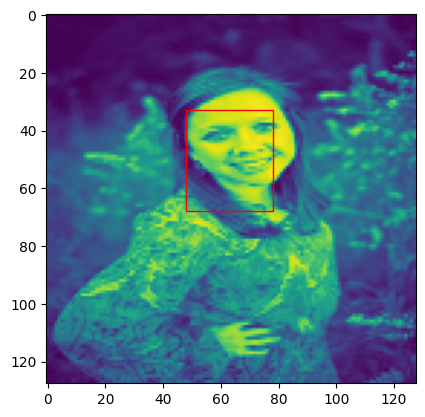

248/248 [==============================] - 3s 13ms/step - loss: 0.0817 - val_loss: 0.1213
Epoch 45/60
1/1 [==============================] - 0s 48ms/step


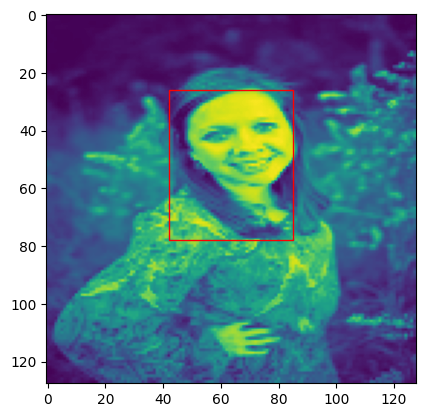

248/248 [==============================] - 4s 16ms/step - loss: 0.0815 - val_loss: 0.1381
Epoch 46/60
1/1 [==============================] - 0s 28ms/step


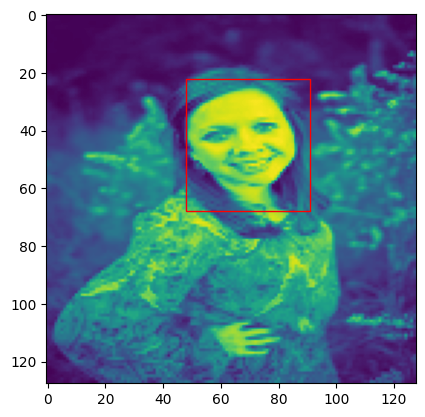

248/248 [==============================] - 3s 14ms/step - loss: 0.0807 - val_loss: 0.1331
Epoch 47/60
1/1 [==============================] - 0s 31ms/step


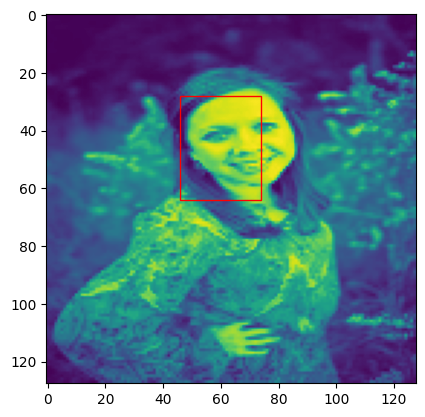

248/248 [==============================] - 3s 13ms/step - loss: 0.0794 - val_loss: 0.1483
Epoch 48/60
1/1 [==============================] - 0s 33ms/step


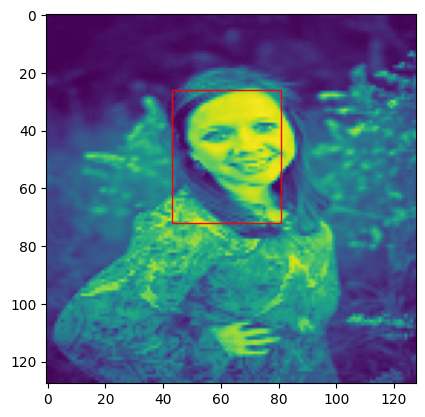

248/248 [==============================] - 3s 13ms/step - loss: 0.0815 - val_loss: 0.1146
Epoch 49/60
1/1 [==============================] - 0s 63ms/step


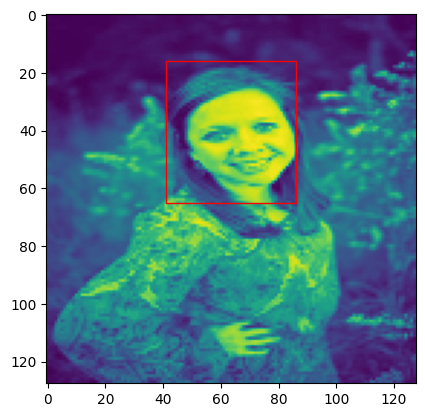

248/248 [==============================] - 4s 15ms/step - loss: 0.0797 - val_loss: 0.1095
Epoch 50/60
1/1 [==============================] - 0s 28ms/step


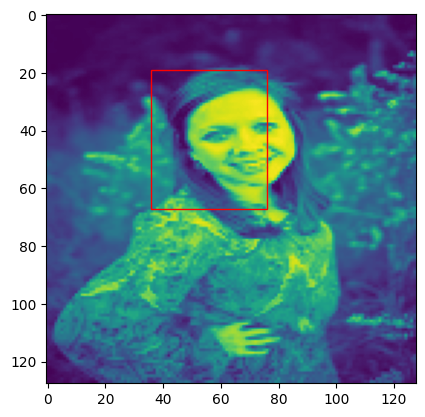

248/248 [==============================] - 3s 14ms/step - loss: 0.0792 - val_loss: 0.1149
Epoch 51/60
1/1 [==============================] - 0s 33ms/step


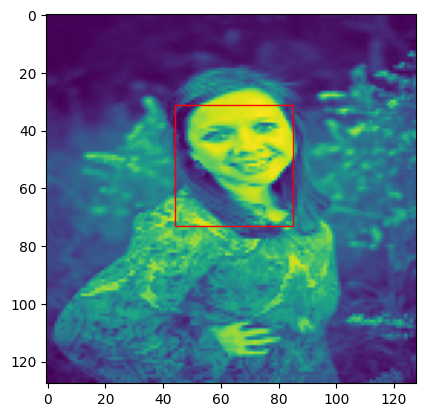

248/248 [==============================] - 3s 13ms/step - loss: 0.0795 - val_loss: 0.1228
Epoch 52/60
1/1 [==============================] - 0s 33ms/step


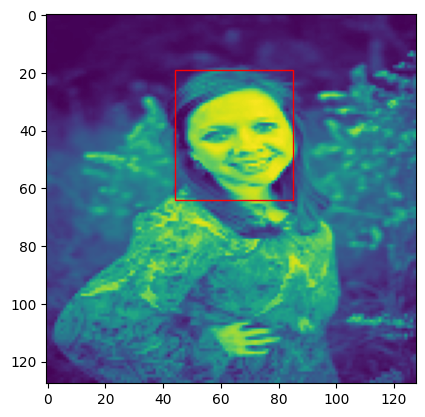

248/248 [==============================] - 3s 14ms/step - loss: 0.0791 - val_loss: 0.1575
Epoch 53/60
1/1 [==============================] - 0s 59ms/step


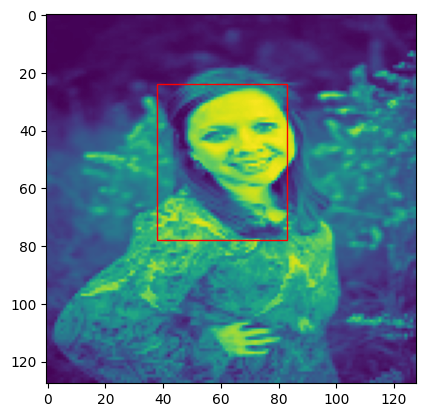

248/248 [==============================] - 4s 15ms/step - loss: 0.0800 - val_loss: 0.1480
Epoch 54/60
1/1 [==============================] - 0s 35ms/step


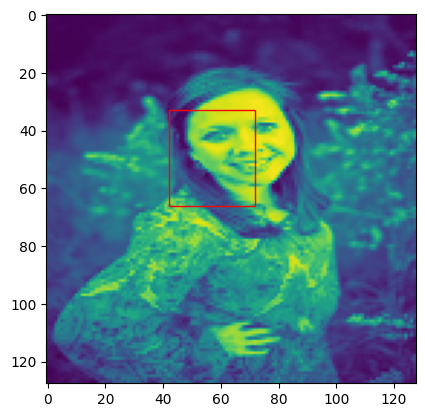

248/248 [==============================] - 4s 16ms/step - loss: 0.0781 - val_loss: 0.1282
Epoch 55/60
1/1 [==============================] - 0s 30ms/step


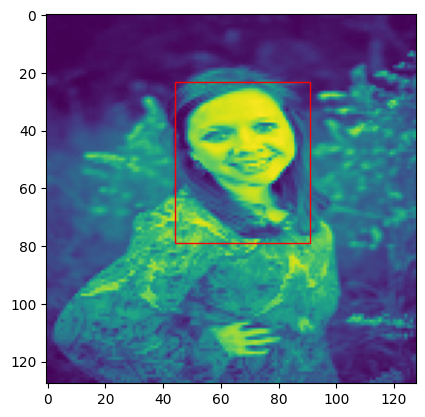

248/248 [==============================] - 3s 14ms/step - loss: 0.0787 - val_loss: 0.1274
Epoch 56/60
1/1 [==============================] - 0s 25ms/step


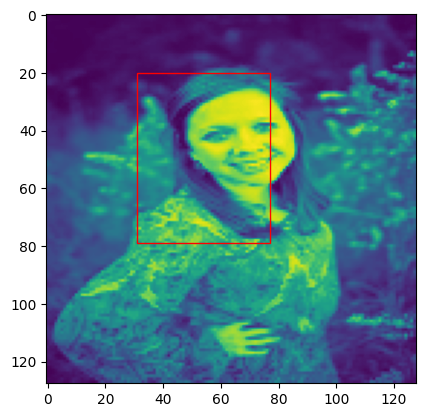

248/248 [==============================] - 3s 13ms/step - loss: 0.0781 - val_loss: 0.1438
Epoch 57/60
1/1 [==============================] - 0s 64ms/step


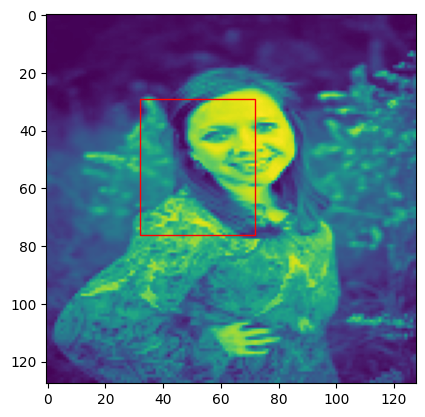

248/248 [==============================] - 4s 15ms/step - loss: 0.0787 - val_loss: 0.1453
Epoch 58/60
1/1 [==============================] - 0s 29ms/step


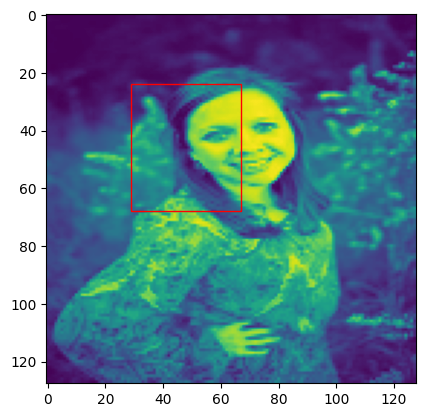

248/248 [==============================] - 3s 14ms/step - loss: 0.0788 - val_loss: 0.1361
Epoch 59/60
1/1 [==============================] - 0s 26ms/step


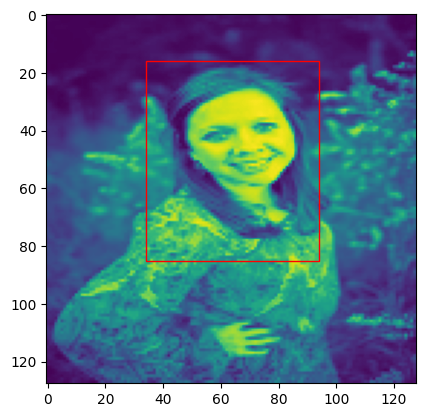

248/248 [==============================] - 3s 13ms/step - loss: 0.0776 - val_loss: 0.1486
Epoch 60/60
1/1 [==============================] - 0s 28ms/step


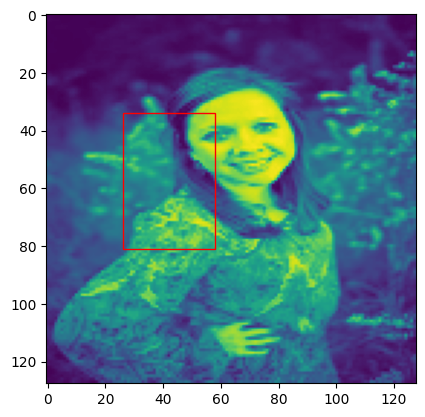

248/248 [==============================] - 3s 13ms/step - loss: 0.0784 - val_loss: 0.1368


In [32]:
history2 = model2.fit(x_train, y_train, validation_data=(x_test, y_test), batch_size=8, epochs=60, callbacks=[CustomCallbacks2()])

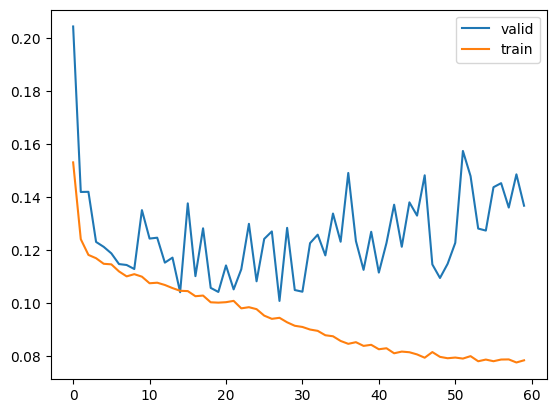

In [33]:
plt.plot(history2.history["val_loss"])
plt.plot(history2.history["loss"])
plt.legend(["valid", "train"])
plt.show()

In [34]:
y_pred2 = model2.predict(x_test)

7/7 [==============================] - 1s 39ms/step


In [35]:
print(f"mean absolute error is {mean_absolute_error(y_pred2, y_test)}")

mean absolute error is 0.024913062214235743


**Plotting the prediction of the models**

In [36]:
def model1_predictions(img_number):
  model1_prediction = model1.predict(x_test[img_number].reshape(1, 128, 128, 1))
  model1_prediction = model1_prediction[0]
  img = x_test[img_number]

  count = 0
  bbox1 = []
  for i in model1_prediction:
    bbox1.append(i)
    count+=1
    if count==4:
      count = 0
      plt.subplot(1,2,1)
      plt.imshow(img)
      x1 = int(bbox1[0]*128)
      y1 = int(bbox1[1]*128)
      x2 = int(bbox1[2]*128)
      y2 = int(bbox1[3]*128)
      plt.gca().add_patch(patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none"))
      bbox1 = []
  plt.show()

1/1 [==============================] - 0s 27ms/step


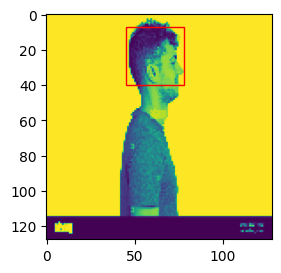

In [37]:
model1_predictions(10)

In [38]:
def model2_predictions(img_number):
  model2_prediction = model2.predict(x_test[img_number].reshape(1, 128, 128, 1))
  model2_prediction = model2_prediction[0]
  img = x_test[img_number]

  count = 0
  bbox1 = []
  for i in model2_prediction:
    bbox1.append(i)
    count+=1
    if count==4:
      count = 0
      plt.subplot(1,2,1)
      plt.imshow(img)
      x1 = int(bbox1[0]*128)
      y1 = int(bbox1[1]*128)
      x2 = int(bbox1[2]*128)
      y2 = int(bbox1[3]*128)
      plt.gca().add_patch(patches.Rectangle((x1, y1), x2-x1, y2-y1, linewidth=1,edgecolor='r', facecolor="none"))
      bbox1 = []
  plt.show()

1/1 [==============================] - 0s 25ms/step


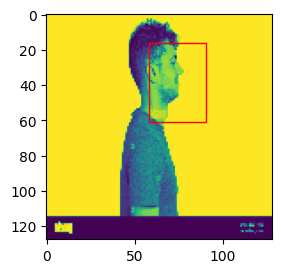

In [39]:
model2_predictions(10)